In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

In [4]:
listing_df = pd.read_csv("listings.csv")
listing_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,5121,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60,30,50,2019-12-02,0.29,2,0,0,NaN
1,2595,Rental unit in New York · ★4.68 · Studio · 1 b...,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240,30,49,2022-06-21,0.30,3,325,1,NaN
2,14991,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120,5,22,2023-05-14,0.14,1,268,3,NaN
3,5136,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276,21,3,2022-08-10,0.03,1,275,1,NaN
4,59709,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325,7,69,2023-04-28,0.47,1,38,23,NaN


In [5]:
listing_df.shape

(43566, 18)

In [6]:
neighbourhoods_df = pd.read_csv("neighbourhoods.csv")
neighbourhoods_df.head()

,neighbourhood_group,neighbourhood
0,Bronx,Allerton
1,Bronx,Baychester
2,Bronx,Belmont
3,Bronx,Bronxdale
4,Bronx,Castle Hill


In [7]:
neighbourhoods_df.shape


(230, 2)

In [8]:

df_combined = pd.concat([listing_df, neighbourhoods_df])# concat listing and neighbour in neighbourhood and neighbourhood_group
df_combined.head()


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,2019-12-02,0.29,2.0,0.0,0.0,NaN
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,2022-06-21,0.30,3.0,325.0,1.0,NaN
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,2023-05-14,0.14,1.0,268.0,3.0,NaN
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,2022-08-10,0.03,1.0,275.0,1.0,NaN
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,2023-04-28,0.47,1.0,38.0,23.0,NaN


In [9]:
df_combined.shape

(43796, 18)

In [16]:
reviw_df = pd.read_csv("reviews.csv")
reviw_df.head()

,listing_id,date
0,5121,2009-05-28
1,2595,2009-11-21
2,2595,2009-12-05
3,2595,2009-12-10
4,2595,2010-04-09


In [17]:
reviw_df['last_review'] = reviw_df['date']# change date column to be last review to concat the two files 

In [18]:
reviw_df.drop(['date'],axis = 1,inplace =True)
reviw_df.head()

,listing_id,last_review
0,5121,2009-05-28
1,2595,2009-11-21
2,2595,2009-12-05
3,2595,2009-12-10
4,2595,2010-04-09


In [19]:
reviw_df.shape

(1148772, 2)

In [20]:
df = pd.concat([df_combined, reviw_df])
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,listing_id
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,2019-12-02,0.29,2.0,0.0,0.0,NaN,NaN
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,2022-06-21,0.30,3.0,325.0,1.0,NaN,NaN
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,2023-05-14,0.14,1.0,268.0,3.0,NaN,NaN
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,2022-08-10,0.03,1.0,275.0,1.0,NaN,NaN
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,2023-04-28,0.47,1.0,38.0,23.0,NaN,NaN


In [21]:
# Clean Data:
df.isna().sum()/(df.shape[0]) * 100
    

id                                 96.346875
name                               96.346875
host_id                            96.346875
host_name                          96.347294
neighbourhood_group                96.327589
neighbourhood                      96.327589
latitude                           96.346875
longitude                          96.346875
room_type                          96.346875
price                              96.346875
minimum_nights                     96.346875
number_of_reviews                  96.346875
last_review                         0.899404
reviews_per_month                  97.226993
calculated_host_listings_count     96.346875
availability_365                   96.346875
number_of_reviews_ltm              96.346875
license                           100.000000
listing_id                          3.672411
dtype: float64

# we have that column last review and listing id have  less than 1 % and 3.6 % respectively so when we delete them the data will not be affected  so let's drop them

In [22]:
df.drop(['listing_id',"last_review","license"],axis = 1,inplace =True)

In [23]:
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,0.29,2.0,0.0,0.0
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,0.30,3.0,325.0,1.0
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,0.14,1.0,268.0,3.0
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,0.03,1.0,275.0,1.0
4,59709.0,Rental unit in New York · ★4.77 · 2 bedrooms ·...,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.71780,-73.99320,Entire home/apt,325.0,7.0,69.0,0.47,1.0,38.0,23.0


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1192568 entries, 0 to 1148771
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              43566 non-null  float64
 1   name                            43566 non-null  object 
 2   host_id                         43566 non-null  float64
 3   host_name                       43561 non-null  object 
 4   neighbourhood_group             43796 non-null  object 
 5   neighbourhood                   43796 non-null  object 
 6   latitude                        43566 non-null  float64
 7   longitude                       43566 non-null  float64
 8   room_type                       43566 non-null  object 
 9   price                           43566 non-null  float64
 10  minimum_nights                  43566 non-null  float64
 11  number_of_reviews               43566 non-null  float64
 12  reviews_per_month           

In [24]:
df.fillna({'reviews_per_month':0}, inplace=True)
df.reviews_per_month.isnull().sum()

0

# we can remove anothe nan values  as they just 4% of our data


In [27]:
df =df.fillna(0)
df.head(4)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,5121.0,Rental unit in Brooklyn · ★4.52 · 1 bedroom · ...,7356.0,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60.0,30.0,50.0,0.29,2.0,0.0,0.0
1,2595.0,Rental unit in New York · ★4.68 · Studio · 1 b...,2845.0,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,240.0,30.0,49.0,0.30,3.0,325.0,1.0
2,14991.0,Rental unit in New York · ★4.93 · 1 bedroom · ...,59023.0,Bianca,Manhattan,Lower East Side,40.72207,-73.98976,Private room,120.0,5.0,22.0,0.14,1.0,268.0,3.0
3,5136.0,Rental unit in Brooklyn · ★5.0 · 2 bedrooms · ...,7378.0,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,276.0,21.0,3.0,0.03,1.0,275.0,1.0


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1192568 entries, 0 to 1148771
Data columns (total 16 columns):
 #   Column                          Non-Null Count    Dtype  
---  ------                          --------------    -----  
 0   id                              1192568 non-null  float64
 1   name                            1192568 non-null  object 
 2   host_id                         1192568 non-null  float64
 3   host_name                       1192568 non-null  object 
 4   neighbourhood_group             1192568 non-null  object 
 5   neighbourhood                   1192568 non-null  object 
 6   latitude                        1192568 non-null  float64
 7   longitude                       1192568 non-null  float64
 8   room_type                       1192568 non-null  object 
 9   price                           1192568 non-null  float64
 10  minimum_nights                  1192568 non-null  float64
 11  number_of_reviews               1192568 non-null  float64
 12  

In [68]:
df.shape

(1192568, 16)

In [28]:
df.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Bronx', 'Queens', 'Staten Island', 0],
      dtype=object)

## We have 5 neighbourhood :
- 'Brooklyn'
- 'Manhattan'
- 'Bronx'
- 'Queens'
- 'Staten Island'

### The following plot represents the count of Airbnb's in the different neighbourhood groups. From the plot, we can easily visualize that maximum number of houses or apartments listed on Airbnb is in Manhatten

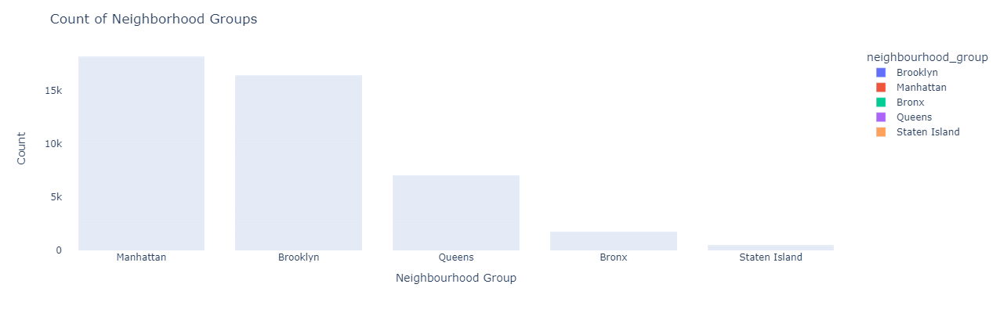

In [47]:
fig = px.bar(df, x="neighbourhood_group", color="neighbourhood_group")

fig.update_layout(
    title="Count of Neighborhood Groups",
    xaxis_title="Neighbourhood Group",
    yaxis_title="Count",
    width=700, 
    height=400
)

fig.update_layout(
  plot_bgcolor='rgba(0,0,0,0)'
)

fig.update_xaxes(categoryorder='total descending') 

fig.show()

In [22]:
df.host_name.unique()

array(['Garon', 'Jennifer', 'Bianca', ..., 'Einab', 'Quick Stay',
       'Sohaib'], dtype=object)

In [33]:
df = df[df['neighbourhood_group'] != 0]
df = df[df['room_type'] != 0]

In [34]:
#Average_price of property according to the location
avg_preffered_price_df = df.groupby(['neighbourhood_group','room_type'], as_index=False)['price'].mean().rename(columns={'neighbourhood_group':'Location','price':'Average Price'})
avg_preffered_price_df
     

,Location,room_type,Average Price
0,Bronx,Entire home/apt,161.659873
1,Bronx,Hotel room,0.000000
2,Bronx,Private room,99.129105
3,Bronx,Shared room,62.690476
4,Brooklyn,Entire home/apt,224.437725
5,Brooklyn,Hotel room,249.166667
6,Brooklyn,Private room,117.677477
7,Brooklyn,Shared room,104.789744
8,Manhattan,Entire home/apt,341.433282
9,Manhattan,Hotel room,512.080292


In [68]:
#Unstack the group by information for plot the graph
avg_preffered_price_df = df.groupby(['neighbourhood_group','room_type'])['price'].mean().unstack()
avg_preffered_price_df

room_type,Entire home/apt,Hotel room,Private room,Shared room
neighbourhood_group,,,,
Bronx,161.659873,10.000000,99.129105,62.690476
Brooklyn,224.437725,250.833333,117.677477,104.789744
Manhattan,341.433282,513.102190,242.668877,190.049505
Queens,196.557901,196.571429,110.154823,81.543478
Staten Island,173.777344,NaN,456.172414,99.000000


<Axes: xlabel='neighbourhood_group'>

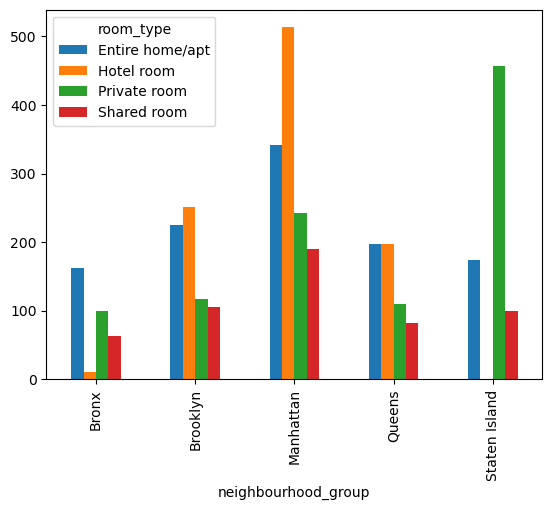

In [69]:
#Graph of average price of property according to location
avg_preffered_price_df.plot.bar()

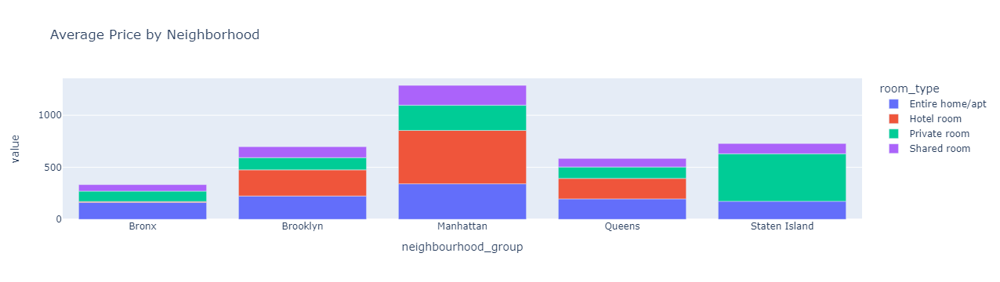

In [70]:
fig = px.bar(avg_preffered_price_df, 
             x=avg_preffered_price_df.index, 
             y=avg_preffered_price_df.columns,
             labels={'x':'Neighborhood', 'y':'Average Price'},
             title='Average Price by Neighborhood')

fig.update_layout(hovermode='closest')

In [71]:
#Apply group by operation on neighbourhood_group for find the number of host according to location
no_of_host_per_location = df.groupby('neighbourhood_group',as_index=False)['host_id'].count().sort_values(['host_id'], ascending=False).rename(columns={'neighbourhood_group':'Location','host_id':'Host'})
no_of_host_per_location
     

,Location,Host
2,Manhattan,18107
1,Brooklyn,16343
3,Queens,6972
0,Bronx,1711
4,Staten Island,433


- Manhattan is most focused place for host to do their business

# we fond that the min price is  0 and it's not free so we need to replace 0 with the second minumim price 

In [72]:
df_no_zeros = df[df['price'] != 0]
second_min = df_no_zeros['price'].nsmallest(6).iloc[1]

print(second_min)

10.0


In [73]:
 df['price'].replace(0, second_min, inplace=True)

In [74]:
#Get the lowest rent according to location
min_price_df = df.groupby('neighbourhood_group',as_index=False)['price'].min().sort_values(['price'],ascending = True).rename(columns = {'price':'Minimum price','neighbourhood_group':'Location'})
min_price_df

,Location,Minimum price
0,Bronx,10.0
1,Brooklyn,10.0
2,Manhattan,10.0
3,Queens,10.0
4,Staten Island,33.0


In [75]:
#Get the highest rent according to location
max_price_df = df.groupby('neighbourhood_group',as_index=False)['price'].max().sort_values(['price'],ascending = False).rename(columns = {'price':'Maximum price','neighbourhood_group':'Location'})
max_price_df

,Location,Maximum price
3,Queens,90120.0
1,Brooklyn,70100.0
4,Staten Island,65115.0
2,Manhattan,59386.0
0,Bronx,9994.0


In [76]:
#Get the host based on number of reviews
host_based_on_review_df = df.groupby(['host_id','host_name',"neighbourhood_group"],as_index=False)['number_of_reviews'].sum().sort_values(['number_of_reviews'],ascending = False)
host_based_on_review_df.head()

,host_id,host_name,neighbourhood_group,number_of_reviews
20931,219517861.0,Sonder (NYC),Manhattan,5928.0
24058,371972456.0,Justin,Manhattan,4838.0
24608,397872858.0,M,Manhattan,3566.0
21309,232251881.0,Lakshmee,Queens,3291.0
22093,266755066.0,The Ridge,Manhattan,3226.0


- The host with the most reviews is "Sonder (NYC)" in Manhattan with 5928 reviews.
- The host with the 2nd most reviews is "Justin" in Manhattan with 4838 reviews.
- The host with the least reviews is "Lakshmee" in Queens with 3291 reviews.
- In general, Manhattan hosts have a higher number of reviews than the one Queens host.

In [23]:
cat_columns = ['neighbourhood_group','neighbourhood','room_type','host_name']

for col in df[cat_columns]:
    if df[col].dtype == 'object':
        print(df[col].unique())
    else:
        print("Not object")

['Brooklyn' 'Manhattan' 'Bronx' 'Queens' 'Staten Island' 0]
['Bedford-Stuyvesant' 'Midtown' 'Lower East Side' 'Sunset Park'
 'Chinatown' 'Upper West Side' 'South Slope' 'Tribeca' 'Williamsburg'
 'Chelsea' 'East Village' 'Greenwich Village' 'Clinton Hill' 'East Harlem'
 'Harlem' 'Washington Heights' 'Upper East Side' 'Fort Greene'
 'Greenpoint' 'Clason Point' 'Kips Bay' 'Eastchester' 'Flatbush'
 "Hell's Kitchen" 'Crown Heights' 'Carroll Gardens' 'West Village'
 'Nolita' 'Park Slope' 'Long Island City' 'East Flatbush' 'Gowanus'
 'Forest Hills' 'Murray Hill' 'Prospect Heights' 'Astoria' 'Boerum Hill'
 'Sunnyside' 'Kingsbridge' 'St. George' 'Ridgewood' 'Mott Haven'
 'Morningside Heights' 'Bushwick' 'Ditmars Steinway' 'Middle Village'
 'Jamaica' 'Windsor Terrace' 'University Heights' 'Brooklyn Heights'
 'Flatiron District' 'Rockaway Beach' 'Allerton' 'Emerson Hill'
 'East New York' 'Theater District' 'Fort Hamilton' 'Bensonhurst'
 'Rego Park' 'Wakefield' 'Kensington' 'Stuyvesant Town' 'Wood

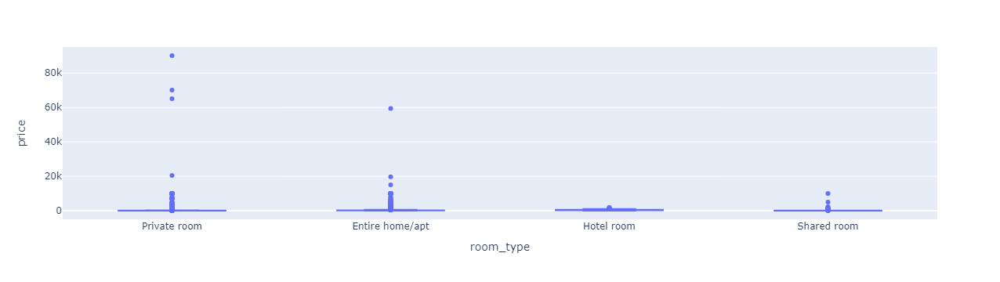

In [78]:
fig = px.box(df, x='room_type', y='price')
fig.show()

 ## 
-  Private room are the most expensive type of rooms  with range price 200 to more  than 90K and this is normal 
- minimum price  of private is 10 doller  and the median is 79 and the maximum price is 90.12K 
-  The second one is Entire home with range from 500 to 59k
- also the min is 10 doller and the median is 190 and the maximum is 59.38k 
- followed by shared rooms with  range 191 to 10K 
- min is 15  and with median 60 and maximum price is 10k 
-  Hotel room are the less one  with median 410  and the maximum price is 1880$

 

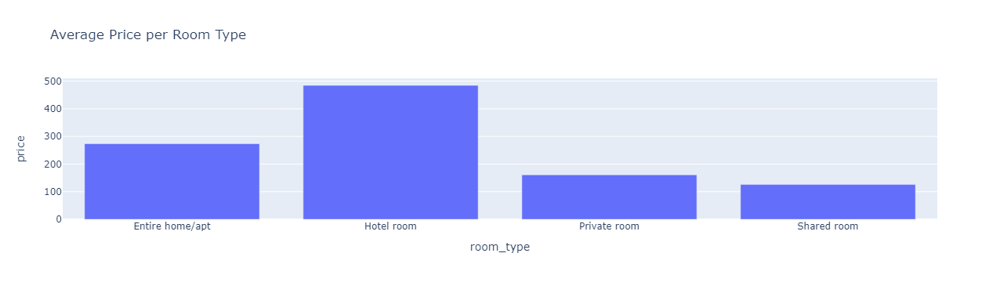

In [79]:
avg_prices = df.groupby('room_type')['price'].mean().reset_index()

fig = px.bar(avg_prices, x='room_type', y='price', 
             title='Average Price per Room Type')
fig.show()


 ## we toked the avarge of price so the most expesive room is the hotel  with more than 480 

- Hotel rooms with avarage price 483.6 $

- Entire rooms with 273 $

- private rooms with avarage 160 $

- shared rooms with 125 $

In [82]:
hosts = df.groupby(['neighbourhood_group',"room_type"])['host_name'].value_counts()
print(hosts.nlargest(10)) 

neighbourhood_group  room_type        host_name      
Manhattan            Entire home/apt  Blueground         517
Brooklyn             Private room     Eugene             418
Manhattan            Entire home/apt  RoomPicks          298
                     Private room     June               264
                                      RoomPicks          195
                     Entire home/apt  Jeniffer           173
Queens               Private room     Hiroki             168
Manhattan            Entire home/apt  Urban Furnished    164
Queens               Private room     Shogo              160
Manhattan            Entire home/apt  Michael            152
Name: host_name, dtype: int64


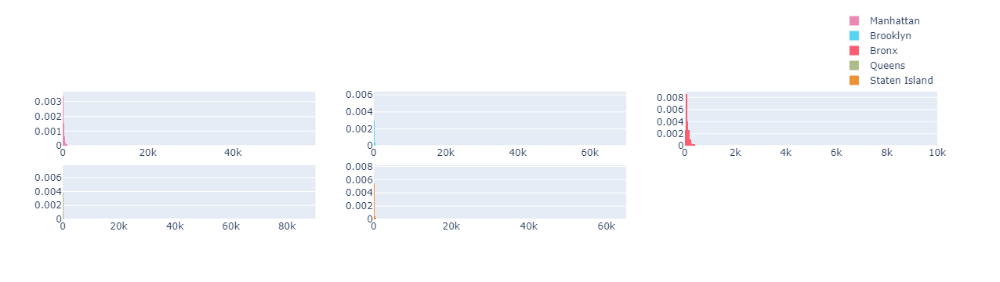

In [66]:
df1 = df[df['neighbourhood_group']=='Manhattan']['price']
df2 = df[df['neighbourhood_group']=='Brooklyn']['price']
df3 = df[df['neighbourhood_group']=='Bronx']['price']  
df4 = df[df['neighbourhood_group']=='Queens']['price']
df5 = df[df['neighbourhood_group']=='Staten Island']['price']

fig = make_subplots(rows=2, cols=3)

fig.add_trace(px.histogram(df1, histnorm='probability density').data[0], row=1, col=1)
fig.data[0].name = 'Manhattan'
fig.data[0].marker.color = '#EB89B5'

fig.add_trace(px.histogram(df2, histnorm='probability density').data[0], row=1, col=2) 
fig.data[1].name = 'Brooklyn'
fig.data[1].marker.color = '#57D4F1'

fig.add_trace(px.histogram(df3, histnorm='probability density').data[0], row=1, col=3)
fig.data[2].name = 'Bronx'
fig.data[2].marker.color = '#FC5E71'

fig.add_trace(px.histogram(df4, histnorm='probability density').data[0], row=2, col=1)
fig.data[3].name = 'Queens' 
fig.data[3].marker.color = '#ACBD89'

fig.add_trace(px.histogram(df5, histnorm='probability density').data[0], row=2, col=2)
fig.data[4].name = 'Staten Island'
fig.data[4].marker.color = '#EF9235' 

fig.update_layout(
   legend=dict(
       orientation="h",
       yanchor="bottom",
       y=1,
       xanchor="right",
       x=1
   )
)
max_price = df['price'].max() 
fig.update_layout(
   legend_title_text=' '
 
)

fig.show()

- The price distribution of Airbnb in Manhattan averages around 80-490 dollars per night depending upon the neighbourhood
- The price distribution of Airbnb in Queens averages around 60-280 dollars per night depending upon the neighbourhood.
- The price distribution of Airbnb in Staten Islands averages around 50-800 dollars per night depending upon the neighbourhood.
- The price distribution of Airbnb in Bronx averages around 50-450 dollars per night depending upon the neighbourhood

In [27]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5)
kmeans.fit(df[['latitude', 'longitude']]) 

df['cluster'] = kmeans.predict(df[['latitude', 'longitude']])

C:\Users\ayama\.anaconda\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [28]:
df['cluster']

0        2
1        0
2        0
3        1
4        0
        ..
43561    2
43562    1
43563    0
43564    2
43565    0
Name: cluster, Length: 43566, dtype: int32

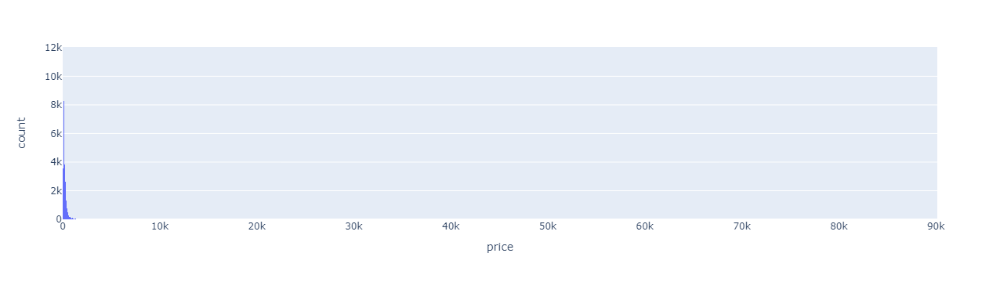

In [29]:
fig = px.histogram(df, x="price")

fig.show() 


- price af rooms are under 10K $


- their exist 11.446k  with price from 50 to 99 $

- 1604 with price from 300  to 349 $

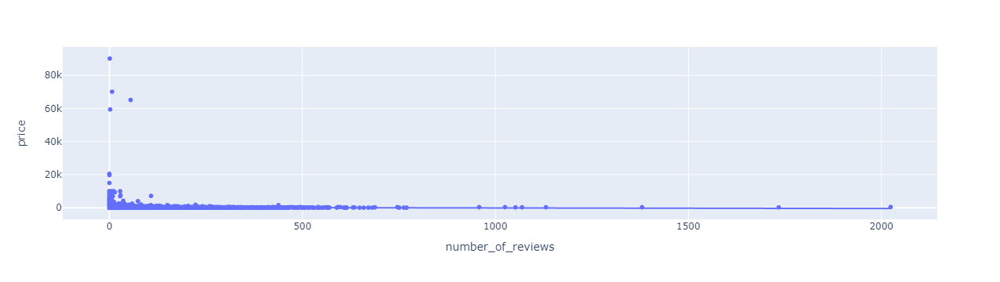

In [30]:
fig = px.scatter(df, x="number_of_reviews", y="price",trendline="ols")
fig.show() 


#### while the price is high the number of reviews is low 
- when the price is in range 20K and lower the reviews are large 

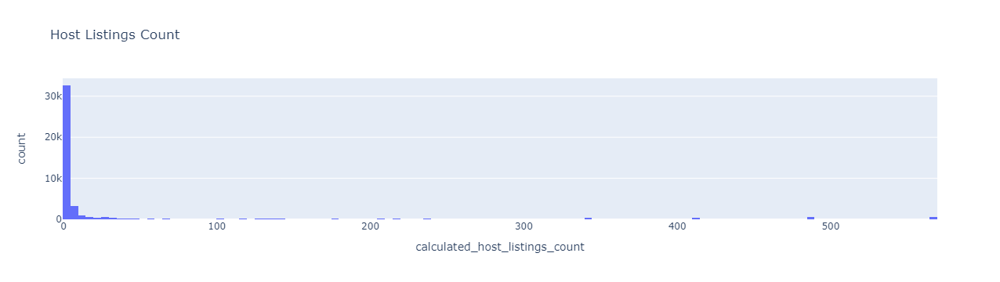

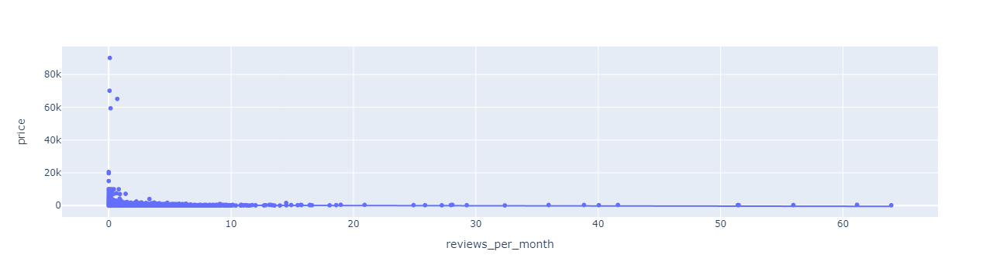

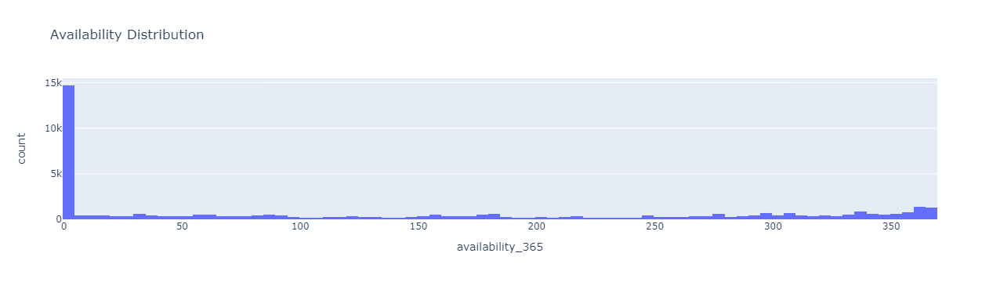

In [31]:

# Host listings count distribution
fig = px.histogram(df, x="calculated_host_listings_count", title='Host Listings Count')
fig.show()

# Reviews per month vs price 
fig = px.scatter(df, x="reviews_per_month", y="price", trendline="ols")
fig.show()

# Availability distribution
fig = px.histogram(df, x="availability_365", title='Availability Distribution')
fig.show()


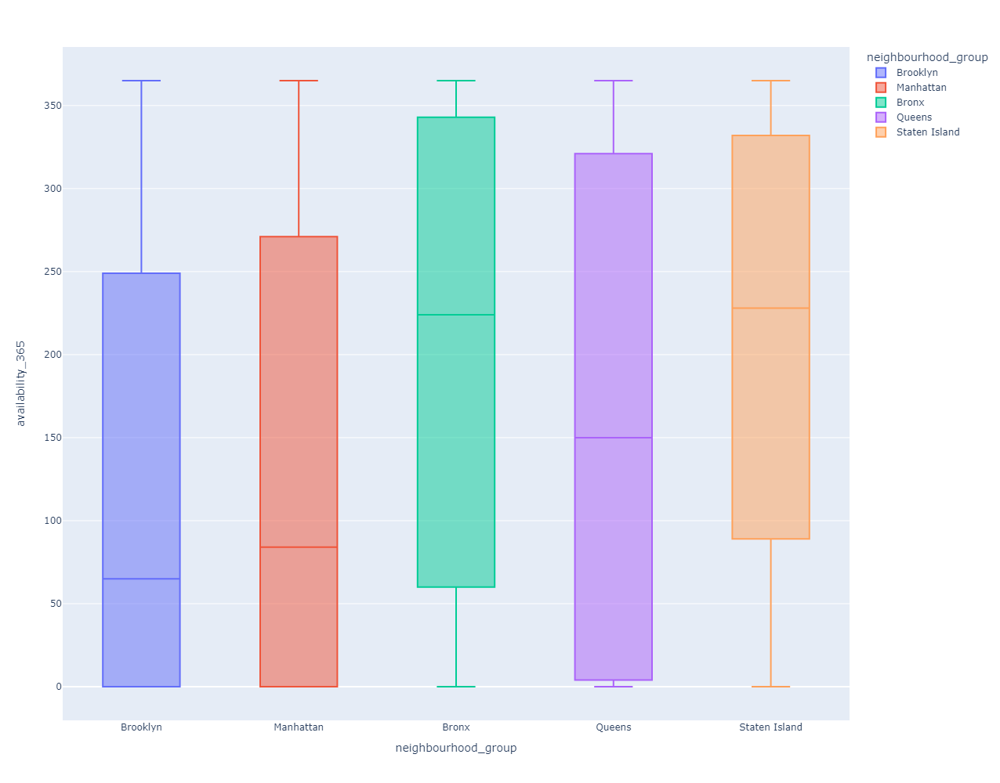

In [32]:

fig = px.box(df, x='neighbourhood_group', y='availability_365', color='neighbourhood_group')

fig.update_layout(
    width=1000,
    height=1000
)

fig.update_traces(quartilemethod="exclusive")

fig.show()

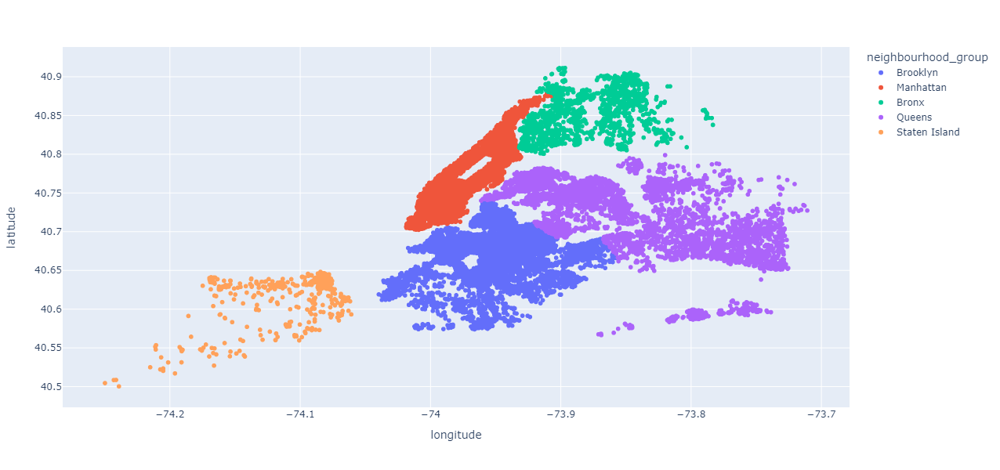

In [33]:
fig = px.scatter(df, x="longitude", y="latitude", color="neighbourhood_group")

fig.update_layout(
    width=1000, 
    height=600
)

fig.show()

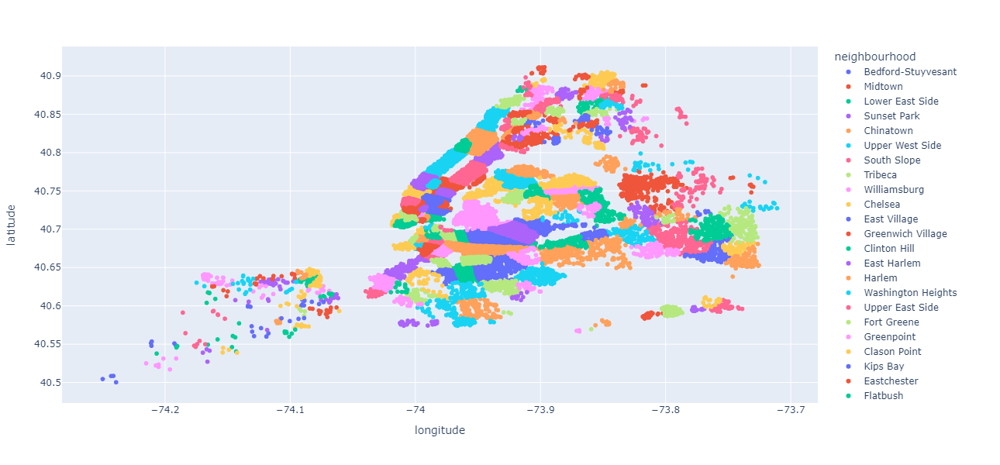

In [34]:
fig = px.scatter(df, x="longitude", y="latitude", color="neighbourhood")

fig.update_layout(
    width=1000,
    height=600  
)

fig.show()

# creating a pie chart to visualize the distribution of listing prices by neighborhood group


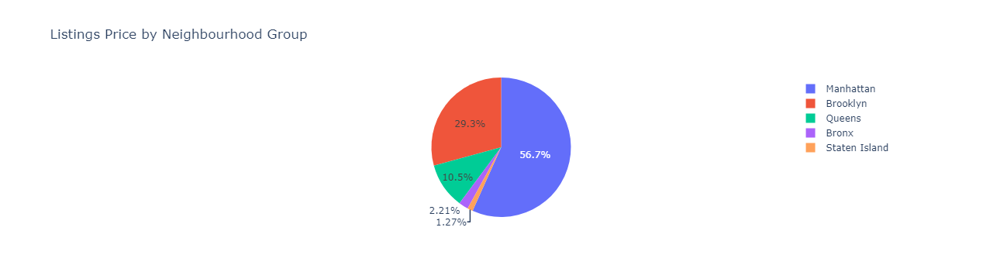

In [35]:
# creating a pie chart to visualize the distribution of listing prices by neighborhood group
fig = px.pie(df, values='price', 
             names='neighbourhood_group',  
             title='Listings Price by Neighbourhood Group')

fig.update_traces(hovertemplate='%{label}: <br>$%{value:,.0f}') 
fig.show()

- Manhatten neighborhood prices group with 56.7%
- Brooklen with 29.3%
- Queens with 10.5
- Broxen with 2.21%
- staten island with 1.2%

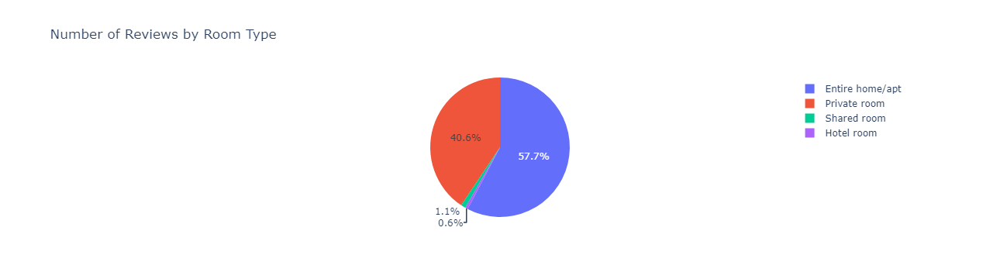

In [36]:
fig = px.pie(df, values='number_of_reviews', 
             names='room_type',
             title='Number of Reviews by Room Type')

fig.update_traces(hovertemplate='%{label}: <br>%{value:,}')
fig.show()


- number of reviews in Entire rooms is 57.7%
- private rooms with 40.6%
- shared rooms with 1.15%
- hotel rooms with 0.6%

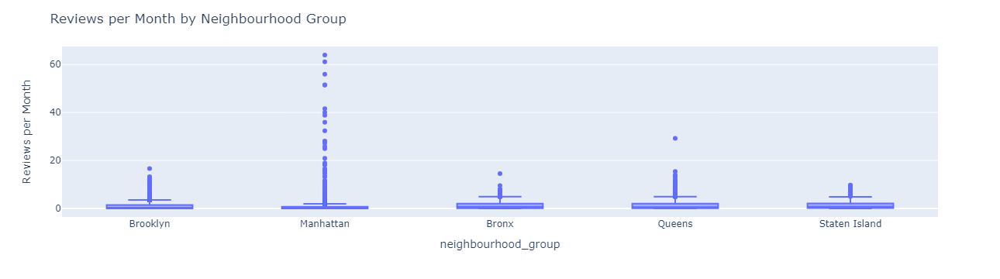

In [37]:
fig = px.box(df, x='neighbourhood_group', y='reviews_per_month')

fig.update_layout(title='Reviews per Month by Neighbourhood Group',
                  yaxis_title='Reviews per Month')

fig.show()

### The graph above is depicting outliers for different neighbourhood groups.

### Outliers can be defined as an observation that lies an abnormal distance from other values in a random sample from a population.

### Which neighbourhood is generating maximum and minimum revenues in terms of private rooms,shared rooms and entire homes?

In [45]:
df_n_roomtype = df.groupby(['neighbourhood','room_type']).agg({'price':'sum'})
df_n_roomtype

price
neighbourhood room_type               
Allerton      Entire home/apt   4383.0
              Private room      2498.0
Arden Heights Entire home/apt    734.0
              Private room        40.0
Arrochar      Entire home/apt   1360.0
...                                ...
Woodrow       Entire home/apt     95.0
              Private room       130.0
Woodside      Entire home/apt  18771.0
              Private room     15286.0
              Shared room        193.0

[546 rows x 1 columns]

In [68]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'cluster'],
      dtype='object')

In [ ]:
df1 = df.host_id.value_counts().head(10)
f,ax = plt.subplots(figsize=(16,5))
ax = sns.barplot(x = df1.index,y=df1.values,palette="muted")
plt.show()

In [40]:
numeric_cols = df.select_dtypes(exclude=[object, 'category'])
numeric_cols

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,cluster
0,5.121000e+03,7356.0,40.685350,-73.955120,60.0,30.0,50.0,0.29,2.0,0.0,0.0,2
1,2.595000e+03,2845.0,40.753560,-73.985590,240.0,30.0,49.0,0.30,3.0,325.0,1.0,0
2,1.499100e+04,59023.0,40.722070,-73.989760,120.0,5.0,22.0,0.14,1.0,268.0,3.0,0
3,5.136000e+03,7378.0,40.662650,-73.994540,276.0,21.0,3.0,0.03,1.0,275.0,1.0,1
4,5.970900e+04,186084.0,40.717800,-73.993200,325.0,7.0,69.0,0.47,1.0,38.0,23.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
43561,9.050311e+17,86368678.0,40.633458,-73.899472,208.0,3.0,0.0,0.00,3.0,358.0,0.0,2
43562,9.050384e+17,52064945.0,40.677256,-73.981435,530.0,30.0,0.0,0.00,1.0,270.0,0.0,1
43563,9.050666e+17,22541573.0,40.732530,-73.989880,382.0,30.0,0.0,0.00,132.0,288.0,0.0,0
43564,9.050779e+17,151692758.0,40.638210,-73.915920,199.0,2.0,0.0,0.00,1.0,155.0,0.0,2


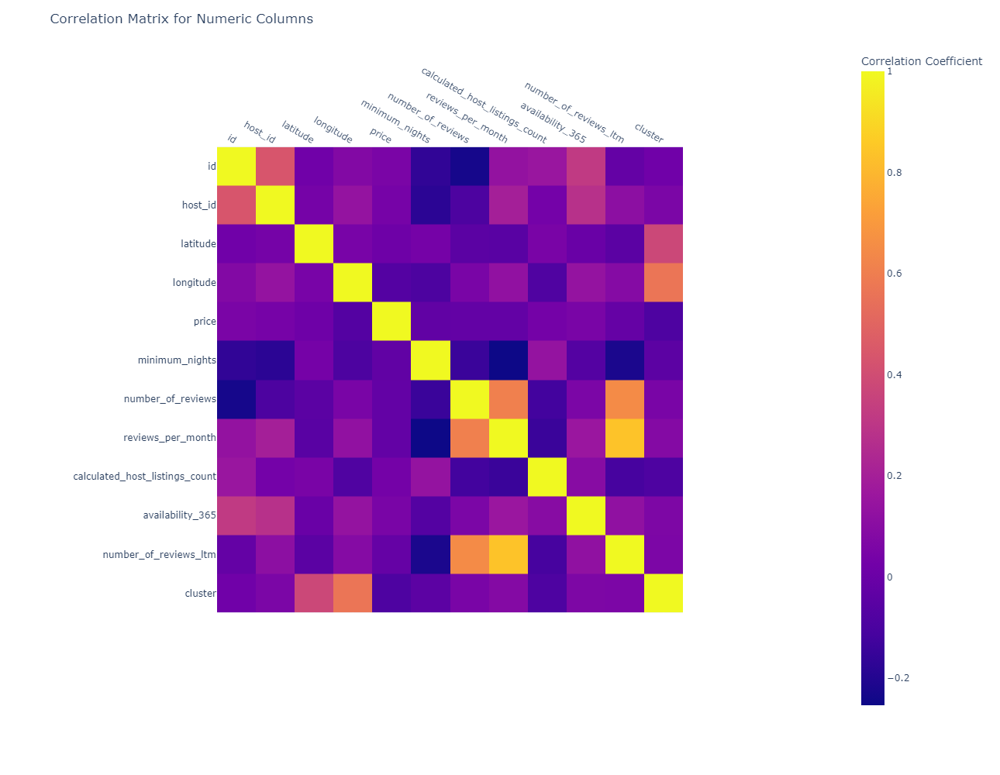

In [43]:
fig = px.imshow(numeric_cols.corr())

fig.update_xaxes(side="top") 

fig.update_layout(
    width=1000,
    height=1000,
    title="Correlation Matrix for Numeric Columns"
)

fig.update_coloraxes(colorbar_title="Correlation Coefficient")

fig.show()

**Null hypothesis**: There is no relationship between reviews per month and listing price.

**Alternative hypothesis**: Listings with more reviews per month have higher prices.

In [73]:
import statsmodels.formula.api as smf

# Fit regression model
model = smf.ols('price ~ reviews_per_month', data=df).fit()  

# Print model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.012
Model:                            OLS   Adj. R-squared:                  0.012
Method:                 Least Squares   F-statistic:                 1.401e+04
Date:                Mon, 04 Sep 2023   Prob (F-statistic):               0.00
Time:                        21:55:02   Log-Likelihood:            -7.7532e+06
No. Observations:             1192568   AIC:                         1.551e+07
Df Residuals:                 1192566   BIC:                         1.551e+07
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             6.5741      0.14

- The p-value for reviews_per_month is 0.000, which is less than 0.05. This means we can reject the null hypothesis and conclude there is a significant relationship between reviews_per_month and price.
- The coefficient for reviews_per_month is -11.26. This suggests that for each additional review per month, price decreases by $11.26 on average.
- The relationship is negative, not positive as we originally hypothesized. More reviews per month are associated with lower prices.
- R-squared is very low, at 0.001. This means reviews_per_month only explains 0.1% of the variation in price.


**Question:** Is there a relationship between number of reviews and availability?

**Null hypothesis:** Number of reviews and availability are independent.

**Alternative:** Listings with higher availability have more reviews.

**Test:** Pearson correlation test between number_of_reviews and availability_365.

In [74]:
from scipy.stats import pearsonr
dfm = df[['number_of_reviews', 'availability_365']] 

# Calculate Pearson correlation
corr, p_value = pearsonr(dfm['number_of_reviews'], dfm['availability_365'])

print('Pearson Correlation:', corr)
print('P-value:', p_value)

Pearson Correlation: 0.3214113851602462
P-value: 0.0


**The output shows there is a small positive correlation of 0.05 between the number of reviews and availability.**
**And the p-value is very low (1.45e-29), which indicates the correlation is statistically significant.**
**So we can reject the null hypothesis and conclude there is a significant, albeit weak, positive correlation between number of reviews and availability.**

## let's play with colum name:

In [75]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm'],
      dtype='object')

In [76]:
df['city'] = df['name'].str.extract(r'in ([A-Za-z\s]+) ·') 
df['city']

0          Brooklyn
1          New York
2          New York
3          Brooklyn
4          New York
             ...   
1148767         NaN
1148768         NaN
1148769         NaN
1148770         NaN
1148771         NaN
Name: city, Length: 1192568, dtype: object

In [77]:
df['review'] = df['name'].str.extract(r'★(\d\.\d{2})')
df['review'] 

0          4.52
1          4.68
2          4.93
3           NaN
4          4.77
           ... 
1148767     NaN
1148768     NaN
1148769     NaN
1148770     NaN
1148771     NaN
Name: review, Length: 1192568, dtype: object

In [78]:
# Extract bedrooms 
df['bedrooms'] = df['name'].str.extract(r'(\d+) bedrooms')
df['bedrooms'] = df['bedrooms'].str.extract(r'(\d+)', expand=False)

# Extract beds
df['beds'] = df['name'].str.extract(r'(\d+) beds')
df['beds'] = df['beds'].str.extract(r'(\d+)', expand=False)

In [79]:
df['bedrooms']

0          NaN
1          NaN
2          NaN
3            2
4            2
          ... 
1148767    NaN
1148768    NaN
1148769    NaN
1148770    NaN
1148771    NaN
Name: bedrooms, Length: 1192568, dtype: object

In [80]:
df['beds'] 

0          NaN
1          NaN
2          NaN
3            2
4            2
          ... 
1148767    NaN
1148768    NaN
1148769    NaN
1148770    NaN
1148771    NaN
Name: beds, Length: 1192568, dtype: object

In [81]:
df['baths'] = df['name'].str.extract(r'(\d+) baths')
df['baths'] = df['baths'].str.extract(r'(\d+)', expand=False)
df['baths']

0          NaN
1          NaN
2          NaN
3            5
4          NaN
          ... 
1148767    NaN
1148768    NaN
1148769    NaN
1148770    NaN
1148771    NaN
Name: baths, Length: 1192568, dtype: object

In [82]:
df.isna().sum()/(df.shape[0])*100

id                                 0.000000
name                               0.000000
host_id                            0.000000
host_name                          0.000000
neighbourhood_group                0.000000
neighbourhood                      0.000000
latitude                           0.000000
longitude                          0.000000
room_type                          0.000000
price                              0.000000
minimum_nights                     0.000000
number_of_reviews                  0.000000
reviews_per_month                  0.000000
calculated_host_listings_count     0.000000
availability_365                   0.000000
number_of_reviews_ltm              0.000000
city                              96.350732
review                            98.273390
bedrooms                          99.055987
beds                              98.666994
baths                             99.546944
dtype: float64

In [83]:
df = df.fillna(0)

In [84]:
df.isna().sum()/(df.shape[0])*100

id                                0.0
name                              0.0
host_id                           0.0
host_name                         0.0
neighbourhood_group               0.0
neighbourhood                     0.0
latitude                          0.0
longitude                         0.0
room_type                         0.0
price                             0.0
minimum_nights                    0.0
number_of_reviews                 0.0
reviews_per_month                 0.0
calculated_host_listings_count    0.0
availability_365                  0.0
number_of_reviews_ltm             0.0
city                              0.0
review                            0.0
bedrooms                          0.0
beds                              0.0
baths                             0.0
dtype: float64

In [ ]:
#df.sample(10)

# extract some new Features

In [85]:
df['review'] = df['review'].astype("float")
df['baths'] = df['baths'].astype("int")
df['bedrooms'] = df['bedrooms'].astype("int")
df['beds'] = df['beds'].astype("int")

In [86]:
df = df[df["beds"]> 0]
df['price_per_bed'] = df['price'] / df['beds']
df.groupby('neighbourhood')['price_per_bed'].mean()

neighbourhood
Allerton           57.783454
Arden Heights      49.291667
Arrochar           47.533333
Arverne            75.339006
Astoria            68.165735
                     ...    
Windsor Terrace    70.408854
Woodhaven          43.496633
Woodlawn           61.047619
Woodrow            35.000000
Woodside           67.245392
Name: price_per_bed, Length: 219, dtype: float64

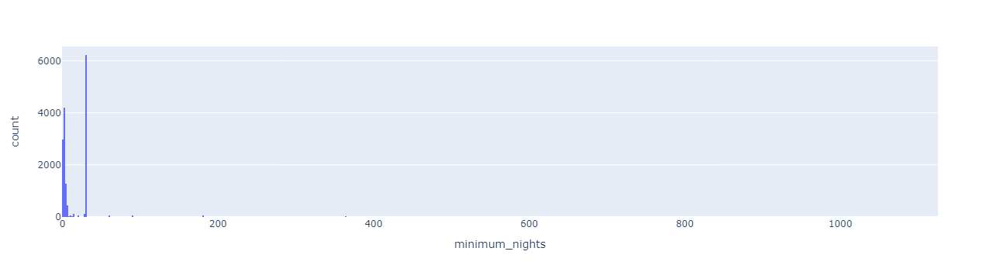

In [88]:
fig = px.histogram(df, x="minimum_nights")
fig.show()

- About 2987 people take 1 night
- About 4205 take 2-3
- About 1289 take 4- 5 night 
- About 447 people take from 6 to 7
- About 117 people take from 14 to 15 night
- About 6220 take 30 to 31

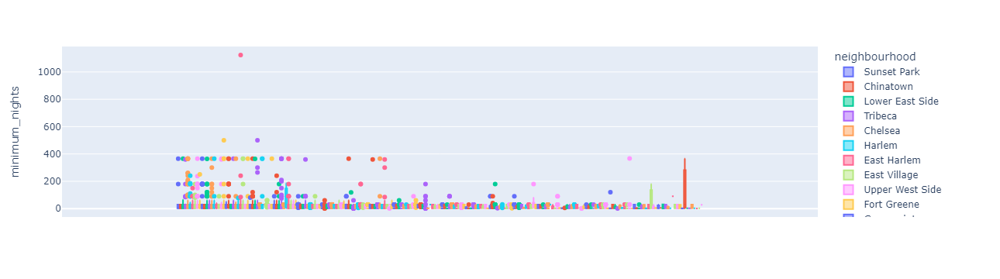

In [89]:
fig = px.box(df, y="minimum_nights", color="neighbourhood")
fig.show()

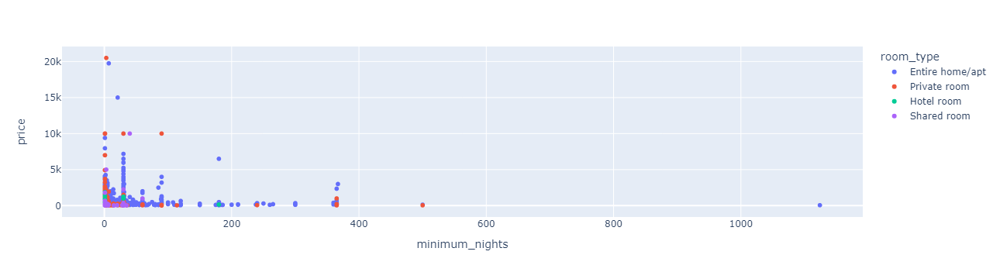

In [91]:
fig = px.scatter(df, x="minimum_nights", y="price",color="room_type")
fig.show()

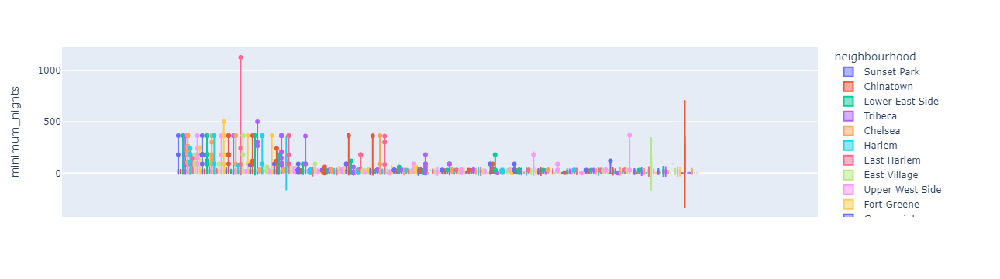

In [92]:
fig = px.violin(df, y="minimum_nights", color="neighbourhood", box=True)
fig.show()

In [93]:
df.drop("name",axis= 1)

,id,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,city,review,bedrooms,beds,baths,price_per_bed
3,5.136000e+03,7378.0,Rebecca,Brooklyn,Sunset Park,40.662650,-73.994540,Entire home/apt,276.0,21.0,...,0.03,1.0,275.0,1.0,Brooklyn,0.00,2,2,5,138.000000
4,5.970900e+04,186084.0,Ricardo & Ashlie,Manhattan,Chinatown,40.717800,-73.993200,Entire home/apt,325.0,7.0,...,0.47,1.0,38.0,23.0,New York,4.77,2,2,0,162.500000
6,1.534100e+04,60049.0,Ted,Manhattan,Lower East Side,40.721359,-73.993668,Entire home/apt,315.0,30.0,...,0.30,1.0,160.0,4.0,New York,4.56,0,2,0,157.500000
9,6.016400e+04,289653.0,Harrison,Manhattan,Tribeca,40.720120,-74.003970,Entire home/apt,500.0,30.0,...,0.77,1.0,45.0,2.0,New York,4.39,3,3,0,166.666667
11,1.539600e+04,60278.0,Petra,Manhattan,Chelsea,40.744930,-73.995210,Entire home/apt,400.0,90.0,...,0.06,1.0,107.0,0.0,New York,0.00,2,2,2,200.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43556,9.050107e+17,40319757.0,Jd And Bailey,Manhattan,Hell's Kitchen,40.766500,-73.988536,Entire home/apt,1400.0,3.0,...,0.00,14.0,362.0,0.0,New York,0.00,3,3,3,466.666667
43558,9.050141e+17,40319757.0,Jd And Bailey,Manhattan,Civic Center,40.714259,-74.005310,Entire home/apt,997.0,1.0,...,0.00,14.0,365.0,0.0,New York,0.00,2,3,2,332.333333
43560,9.050193e+17,40319757.0,Jd And Bailey,Manhattan,Chinatown,40.718730,-74.001030,Entire home/apt,1300.0,1.0,...,0.00,14.0,364.0,0.0,New York,0.00,4,4,0,325.000000
43561,9.050311e+17,86368678.0,Jamel,Brooklyn,Canarsie,40.633458,-73.899472,Entire home/apt,208.0,3.0,...,0.00,3.0,358.0,0.0,Brooklyn,0.00,3,3,0,69.333333
